# 1. Install and Import the libraries and packages.

In [1]:
#install all the libraries
!pip install --upgrade requests branca six jinja2 numpy chardet idna urllib3 certifi MarkupSafe
!conda install -c conda-forge folium --yes
!conda install -c conda-forge geopy --yes
!pip install bs4
!pip install uszipcode
!pip install tqdm

#import all the libraries
import numpy as np # library to handle data in a vectorized manner
import pandas as pd # library for data analsysis
import requests
import random
from sklearn.cluster import KMeans
from pandas.io.json import json_normalize
import folium
from folium.plugins import MiniMap
from geopy.geocoders import Nominatim
import json
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as colors
from sklearn import metrics
from PIL import Image
import matplotlib.patches as mpatches
import types
from botocore.client import Config
import ibm_boto3
from bs4 import BeautifulSoup
from uszipcode import SearchEngine
import geopy
from geopy.extra.rate_limiter import RateLimiter
import tqdm
from tqdm._tqdm_notebook import tqdm_notebook

print('Libraries imported')

     |████████████████████████████████| 71kB 5.8MB/s eta 0:00:011
     |████████████████████████████████| 133kB 16.2MB/s eta 0:00:01
     |████████████████████████████████| 14.6MB 23.1MB/s eta 0:00:01
Requirement already up-to-date: chardet in /opt/conda/envs/Python36/lib/python3.6/site-packages (3.0.4)
     |████████████████████████████████| 61kB 28.6MB/s eta 0:00:01
     |████████████████████████████████| 133kB 51.3MB/s eta 0:00:01
Requirement already up-to-date: certifi in /opt/conda/envs/Python36/lib/python3.6/site-packages (2020.6.20)
ERROR: tensorflow 1.13.1 requires tensorboard<1.14.0,>=1.13.0, which is not installed.
ERROR: ibm-cos-sdk-core 2.4.3 has requirement urllib3<1.25,>=1.20, but you'll have urllib3 1.25.9 which is incompatible.
ERROR: botocore 1.12.82 has requirement urllib3<1.25,>=1.20, but you'll have urllib3 1.25.9 which is incompatible.
ERROR: autoai-libs 1.10.5 has requirement pandas>=0.24.2, but you'll have pandas 0.24.1 which is incompatible.
  Found existing ins

     |████████████████████████████████| 122kB 38.6MB/s eta 0:00:01
     |████████████████████████████████| 51kB 26.2MB/s eta 0:00:01
  Stored in directory: /home/dsxuser/.cache/pip/wheels/ab/eb/a9/b52a501381973eb8336db202c06bba1fa8c2e9cd6e09b9bb24
Successfully built autopep8
ERROR: spyder 3.3.3 requires pyqt5<=5.12; python_version >= "3", which is not installed.
  Found existing installation: pycodestyle 2.5.0
    Uninstalling pycodestyle-2.5.0:
      Successfully uninstalled pycodestyle-2.5.0
Libraries imported


# 2. Load the Neighborhoods of New York and Toronto

* New York: https://ibm.box.com/shared/static/fbpwbovar7lf8p5sgddm06cgipa2rxpe.json

* Toronto: https://en.wikipedia.org/wiki/List_of_postal_codes_of_Canada:_M

## 2.1 Download and load New York Data

In [2]:
# Download and explore the new York City dataset
!wget -q -O 'newyork_data.json' https://cocl.us/new_york_dataset
print('Data downloaded!')

Data downloaded!


In [3]:
with open('newyork_data.json') as json_data:
    newyork_data = json.load(json_data)
    
#Take a look at the data
#newyork_data

In [4]:
#the relevant data is in the features key, which is basically a list of neighborhoods
NY_data = newyork_data['features']

In [5]:
NY_data[0]

{'type': 'Feature',
 'id': 'nyu_2451_34572.1',
 'geometry': {'type': 'Point',
  'coordinates': [-73.84720052054902, 40.89470517661]},
 'geometry_name': 'geom',
 'properties': {'name': 'Wakefield',
  'stacked': 1,
  'annoline1': 'Wakefield',
  'annoline2': None,
  'annoline3': None,
  'annoangle': 0.0,
  'borough': 'Bronx',
  'bbox': [-73.84720052054902,
   40.89470517661,
   -73.84720052054902,
   40.89470517661]}}

### 2.1.1 Let's look at the New York Data

In [6]:
# Transform the NY Data into a Pandas dataframe
# define the dataframe columns
column_names = ['Borough', 'Neighborhood', 'Latitude', 'Longitude'] 

# instantiate the dataframe
NYdf = pd.DataFrame(columns=column_names)

# Make sure the columns are correct
NYdf

,Borough,Neighborhood,Latitude,Longitude


In [7]:
# Then let's loop through the data and fill the dataframe one row at a time
for data in NY_data:
    borough = neighborhood_name = data['properties']['borough'] 
    neighborhood_name = data['properties']['name']
        
    neighborhood_latlon = data['geometry']['coordinates']
    neighborhood_lat = neighborhood_latlon[1]
    neighborhood_lon = neighborhood_latlon[0]
    
    NYdf = NYdf.append({'Borough': borough,
                        'Neighborhood': neighborhood_name,
                        'Latitude': neighborhood_lat,
                        'Longitude': neighborhood_lon}, ignore_index=True)

In [8]:
#Take only the neighborhoods from Manhattan
NYdf =NYdf[NYdf['Borough'] == 'Manhattan'].reset_index(drop=True)

In [9]:
NYdf.head(10)

,Borough,Neighborhood,Latitude,Longitude
0,Manhattan,Marble Hill,40.876551,-73.910660
1,Manhattan,Chinatown,40.715618,-73.994279
2,Manhattan,Washington Heights,40.851903,-73.936900
3,Manhattan,Inwood,40.867684,-73.921210
4,Manhattan,Hamilton Heights,40.823604,-73.949688
5,Manhattan,Manhattanville,40.816934,-73.957385
6,Manhattan,Central Harlem,40.815976,-73.943211
7,Manhattan,East Harlem,40.792249,-73.944182
8,Manhattan,Upper East Side,40.775639,-73.960508
9,Manhattan,Yorkville,40.775930,-73.947118


In [137]:
#Make sure the dataset now has 40 neighborhoods in Manhattan borough.
print("{} neighborhoods found in Manhattan, New York City.".format(NYdf.shape[0]))

40 neighborhoods found in Manhattan, New York City.


## 2.2 Download and load Toronto Data

In [11]:
#Toronto Geographical Data on Neighbhorhoods/Boroughs
Tor_url='https://en.wikipedia.org/w/index.php?title=List_of_postal_codes_of_Canada:_M&oldid=945633050'
Tor_df = pd.read_html(Tor_url)
Tor_df_postcodes=Tor_df[0]
#print('imported dataframe has', Tor_df_postcodes['Postcode'].count(), "postcodes entries")
#Tor_df_postcodes.head(10)
#df_postcodes.dtypes

### 2.2.1 Let's look at the Toronto Data

In [12]:
#Preprocessing
#Toronto - Get rid of the "Not assigned" / Replace

Tor_df_postcodes = Tor_df_postcodes[Tor_df_postcodes["Borough"] != "Not assigned"]

#Replace the N/A values of Neighborhood with the Borough Value
Tor_df_postcodes["Neighbourhood"].replace("Not assigned", Tor_df_postcodes["Borough"], inplace=True)

Tor_df_postcodes.head()

/opt/conda/envs/Python36/lib/python3.6/site-packages/pandas/core/generic.py:6586: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._update_inplace(new_data)


,Postcode,Borough,Neighbourhood
2,M3A,North York,Parkwoods
3,M4A,North York,Victoria Village
4,M5A,Downtown Toronto,Harbourfront
5,M6A,North York,Lawrence Heights
6,M6A,North York,Lawrence Manor


In [13]:
#Now combine all the neighbourhoods with the same postal codes
Tor_df = Tor_df_postcodes.groupby(["Postcode","Borough"])["Neighbourhood"].apply(list)
Tor_df = Tor_df.sample(frac=1).reset_index()
Tor_df["Neighbourhood"] = Tor_df["Neighbourhood"].str.join(', ')
Tor_df.head(10)

,Postcode,Borough,Neighbourhood
0,M1W,Scarborough,L'Amoreaux West
1,M6M,York,"Del Ray, Keelesdale, Mount Dennis, Silverthorn"
2,M7A,Downtown Toronto,Queen's Park
3,M1V,Scarborough,"Agincourt North, L'Amoreaux East, Milliken, St..."
4,M4E,East Toronto,The Beaches
5,M3L,North York,Downsview West
6,M2R,North York,Willowdale West
7,M5J,Downtown Toronto,"Harbourfront East, Toronto Islands, Union Station"
8,M4N,Central Toronto,Lawrence Park
9,M6N,York,"The Junction North, Runnymede"


add latitude and longitude from http://cocl.us/Geospatial_data

In [14]:
#Get the Latitude and Langitude to match the Postcode
!wget -q -O 'Geospatial_Coordinates.csv' http://cocl.us/Geospatial_data
geo = pd.read_csv("Geospatial_Coordinates.csv", index_col = 0)         
Tor_df = Tor_df.join(geo, on = "Postcode")

#Take only those neighborhoods that contain the word Toronto
Tor_df = Tor_df[Tor_df['Borough'].str.contains('Toronto')].reset_index(drop=True)
Tor_df.head()

,Postcode,Borough,Neighbourhood,Latitude,Longitude
0,M7A,Downtown Toronto,Queen's Park,43.662301,-79.389494
1,M4E,East Toronto,The Beaches,43.676357,-79.293031
2,M5J,Downtown Toronto,"Harbourfront East, Toronto Islands, Union Station",43.640816,-79.381752
3,M4N,Central Toronto,Lawrence Park,43.728020,-79.388790
4,M4Y,Downtown Toronto,Church and Wellesley,43.665860,-79.383160


In [15]:
#check to see that there are 38 neighborhoods 
print("\n{} neighborhoods found in the city of Toronto.".format(Tor_df.shape[0]))


39 neighborhoods found in the city of Toronto.


# 2.3 Visualize the neighborhoods in New York and Toronto

### 2.3.1 Get center coordinates to visualize both cities together.

In [16]:
NYaddress = 'Manhattan, NY'

geolocator = Nominatim(user_agent="ny_explorer")
NYlocation = geolocator.geocode(NYaddress)
NYlatitude = NYlocation.latitude
NYlongitude = NYlocation.longitude
print('The geograpical coordinate of New York City are {}, {}.'.format(NYlatitude, NYlongitude))

Toraddress = 'Toronto'
geolocator = Nominatim(user_agent="Toronto_explorer")
Tlocation = geolocator.geocode(Toraddress)
Tlatitude = Tlocation.latitude
Tlongitude = Tlocation.longitude
print('The geographical coordinate of Toronto are {}, {}.'.format(Tlatitude,Tlongitude))

centerLatitude = (NYlatitude + Tlatitude)/2
centerLongitude = (NYlongitude + Tlongitude)/2

print('\nThe geographical central coordinates are {}, {}.'.format(centerLatitude, centerLongitude))

The geograpical coordinate of New York City are 40.7896239, -73.9598939.
The geographical coordinate of Toronto are 43.6534817, -79.3839347.

The geographical central coordinates are 42.2215528, -76.6719143.


### 2.3.2 Append New York and Toronto Tables

In [17]:
tmp = Tor_df.drop("Postcode",axis = 1)
tmp.rename(columns = {"Neighbourhood":"Neighborhood"}, inplace = True)
TorNY_df = NYdf.append(tmp, True).reset_index(drop = True)
pd.set_option('max_rows', 6)
TorNY_df

,Borough,Neighborhood,Latitude,Longitude
0,Manhattan,Marble Hill,40.876551,-73.910660
1,Manhattan,Chinatown,40.715618,-73.994279
2,Manhattan,Washington Heights,40.851903,-73.936900
...,...,...,...,...
76,Downtown Toronto,St. James Town,43.651494,-79.375418
77,Downtown Toronto,Christie,43.669542,-79.422564
78,West Toronto,"Little Portugal, Trinity",43.647927,-79.419750


### 2.3.3 Visualize neighborhoods in Folium Map

In [18]:
map_tony = folium.Map(location=[centerLatitude, centerLongitude], zoom_start=7, width='100%', height='100%')

for lat, lng, borough, neighborhood in zip(TorNY_df['Latitude'], TorNY_df['Longitude'], TorNY_df['Borough'], TorNY_df['Neighborhood']):
    label = '{}, {}'.format(neighborhood, borough)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7).add_to(map_tony)
map_tony

New York City - Manhattan

In [19]:
map_tony = folium.Map(location=[NYlatitude, NYlongitude], zoom_start=11, width='100%', height='100%')

for lat, lng, borough, neighborhood in zip(TorNY_df['Latitude'], TorNY_df['Longitude'], TorNY_df['Borough'], TorNY_df['Neighborhood']):
    label = '{}, {}'.format(neighborhood, borough)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7).add_to(map_tony)

minimap = MiniMap(position = 'topleft', center_fixed = (NYlatitude, NYlongitude), zoom_level_fixed = 8)
minimap.add_to(map_tony)

minimap = MiniMap(position='bottomright',  center_fixed = (Tlatitude, Tlongitude), zoom_level_fixed = 8)
minimap.add_to(map_tony)
map_tony

Toronto

In [20]:
map_tony = folium.Map(location=[Tlatitude, Tlongitude], zoom_start=11, width='100%', height='100%')

for lat, lng, borough, neighborhood in zip(TorNY_df['Latitude'], TorNY_df['Longitude'], TorNY_df['Borough'], TorNY_df['Neighborhood']):
    label = '{}, {}'.format(neighborhood, borough)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7).add_to(map_tony)

minimap = MiniMap(position = 'topleft', center_fixed = (NYlatitude, NYlongitude), zoom_level_fixed = 8)
minimap.add_to(map_tony)

minimap = MiniMap(position='bottomright',  center_fixed = (Tlatitude, Tlongitude), zoom_level_fixed = 8)
minimap.add_to(map_tony)
map_tony

# 3. Load the Crime Data for New York and Toronto

## 3.1 Download and load New York Crime Data

In [21]:
  import types
import pandas as pd
from botocore.client import Config
import ibm_boto3

def __iter__(self): return 0

# @hidden_cell
# The following code accesses a file in your IBM Cloud Object Storage. It includes your credentials.
# You might want to remove those credentials before you share the notebook.
client_e073509e2b4e4fd9ab9d353e029fb9c7 = ibm_boto3.client(service_name='s3',
    ibm_api_key_id='laWUQegt0L87NPNfrypYxAOqgbtrN8Nk-_LhkiQGgNK7',
    ibm_auth_endpoint="https://iam.cloud.ibm.com/oidc/token",
    config=Config(signature_version='oauth'),
    endpoint_url='https://s3-api.us-geo.objectstorage.service.networklayer.com')

body = client_e073509e2b4e4fd9ab9d353e029fb9c7.get_object(Bucket='courseraibmcapstone-donotdelete-pr-iibp9ibtexxq7g',Key='NYPD_Complaint_Data_Current__Year_To_Date_.csv')['Body']
# add missing __iter__ method, so pandas accepts body as file-like object
if not hasattr(body, "__iter__"): body.__iter__ = types.MethodType( __iter__, body )

df_data_4 = pd.read_csv(body)
NYCrime = df_data_4
NYCrime.head()

,CMPLNT_NUM,ADDR_PCT_CD,BORO_NM,CMPLNT_FR_DT,YEAR,Unnamed: 5,Unnamed: 6,CMPLNT_FR_TM,CMPLNT_TO_DT,CMPLNT_TO_TM,...,SUSP_SEX,TRANSIT_DISTRICT,VIC_AGE_GROUP,VIC_RACE,VIC_SEX,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,Lat_Lon
0,466502077,75,BROOKLYN,2020-03-30,2020.0,NaN,NaN,17:30:00,3/31/2020,6:53:00,...,NaN,NaN,25-44,BLACK,M,1018496,178657,40.656991,-73.876574,"(40.65699087900003, -73.87657444799999)"
1,303191835,77,BROOKLYN,2020-03-28,2020.0,NaN,NaN,19:30:00,3/28/2020,20:30:00,...,M,NaN,<18,UNKNOWN,F,1003606,185050,40.674583,-73.930222,"(40.67458330800008, -73.93022154099998)"
2,735488557,43,BRONX,2020-03-29,2020.0,NaN,NaN,14:10:00,NaN,NaN,...,NaN,NaN,UNKNOWN,UNKNOWN,D,1019853,241853,40.830443,-73.871349,"(40.83044253800006, -73.871349147)"
3,315962428,40,BRONX,2020-03-29,2020.0,NaN,NaN,7:10:00,3/29/2020,7:16:00,...,M,NaN,25-44,WHITE HISPANIC,F,1007236,237260,40.817878,-73.916957,"(40.817877907000025, -73.91695668199996)"
4,165437868,114,QUEENS,2020-03-27,2020.0,NaN,NaN,13:15:00,3/27/2020,14:00:00,...,NaN,NaN,45-64,BLACK,F,1002018,213258,40.752011,-73.935872,"(40.75201086000004, -73.93587196099996)"


### 3.1.1 Let's look at the New York Crime Data

In [22]:
NYCrime.columns

Index(['CMPLNT_NUM', 'ADDR_PCT_CD', 'BORO_NM', 'CMPLNT_FR_DT', 'YEAR',
       'Unnamed: 5', 'Unnamed: 6', 'CMPLNT_FR_TM', 'CMPLNT_TO_DT',
       'CMPLNT_TO_TM', 'CRM_ATPT_CPTD_CD', 'HADEVELOPT', 'HOUSING_PSA',
       'JURISDICTION_CODE', 'JURIS_DESC', 'KY_CD', 'LAW_CAT_CD',
       'LOC_OF_OCCUR_DESC', 'OFNS_DESC', 'PARKS_NM', 'PATROL_BORO', 'PD_CD',
       'PD_DESC', 'PREM_TYP_DESC', 'RPT_DT', 'STATION_NAME', 'SUSP_AGE_GROUP',
       'SUSP_RACE', 'SUSP_SEX', 'TRANSIT_DISTRICT', 'VIC_AGE_GROUP',
       'VIC_RACE', 'VIC_SEX', 'X_COORD_CD', 'Y_COORD_CD', 'Latitude',
       'Longitude', 'Lat_Lon'],
      dtype='object')

In [23]:
# Clean the NYCrime Data
#Drop columns that are not needed

NYCrime.drop(['CMPLNT_NUM','YEAR', 'Unnamed: 5', 'Unnamed: 6', 'CMPLNT_FR_TM', 'CMPLNT_TO_DT',
       'CMPLNT_TO_TM', 'CRM_ATPT_CPTD_CD', 'HADEVELOPT',
       'HOUSING_PSA', 'JURISDICTION_CODE', 'JURIS_DESC', 'KY_CD', 'LAW_CAT_CD',
       'LOC_OF_OCCUR_DESC', 'RPT_DT', 'PARKS_NM', 'PATROL_BORO', 'PD_CD',
       'PD_DESC', 'PREM_TYP_DESC','KY_CD', 'PD_CD', 'PD_DESC',
       'CRM_ATPT_CPTD_CD', 'LAW_CAT_CD', 'JURIS_DESC',
       'LOC_OF_OCCUR_DESC', 'PREM_TYP_DESC', 'PARKS_NM',
       'HADEVELOPT', 'STATION_NAME', 'SUSP_AGE_GROUP',
       'SUSP_RACE', 'SUSP_SEX', 'TRANSIT_DISTRICT', 'VIC_AGE_GROUP',
       'VIC_RACE', 'VIC_SEX', 'X_COORD_CD', 'Y_COORD_CD'
             ], axis=1, inplace=True)

#Rename columns names for consistency across all dataframes

NYCrime.rename(columns ={'ADDR_PCT_CD' : 'Precinct Number',
                         'CMPLNT_FR_DT': 'Occurrence Year', 
                         'OFNS_DESC' : 'MCI', 
                         'BORO_NM' : 'Borough',
                         'Latitude' : 'Lat', 
                         'Longitude' : 'Long', 
                         'Lat_Lon' : 'Coordinates'}, inplace=True)

NYCrime.head(5)

,Precinct Number,Borough,Occurrence Year,MCI,Lat,Long,Coordinates
0,75,BROOKLYN,2020-03-30,PETIT LARCENY,40.656991,-73.876574,"(40.65699087900003, -73.87657444799999)"
1,77,BROOKLYN,2020-03-28,RAPE,40.674583,-73.930222,"(40.67458330800008, -73.93022154099998)"
2,43,BRONX,2020-03-29,PETIT LARCENY,40.830443,-73.871349,"(40.83044253800006, -73.871349147)"
3,40,BRONX,2020-03-29,PETIT LARCENY,40.817878,-73.916957,"(40.817877907000025, -73.91695668199996)"
4,114,QUEENS,2020-03-27,ASSAULT 3 & RELATED OFFENSES,40.752011,-73.935872,"(40.75201086000004, -73.93587196099996)"


In [24]:
NYCrime['Occurrence Year'] = pd.to_datetime(NYCrime['Occurrence Year'], format='%Y-%m-%d') #%Y-%m-%d  #%m/%d/%Y

NYCrime.head(5)

,Precinct Number,Borough,Occurrence Year,MCI,Lat,Long,Coordinates
0,75,BROOKLYN,2020-03-30,PETIT LARCENY,40.656991,-73.876574,"(40.65699087900003, -73.87657444799999)"
1,77,BROOKLYN,2020-03-28,RAPE,40.674583,-73.930222,"(40.67458330800008, -73.93022154099998)"
2,43,BRONX,2020-03-29,PETIT LARCENY,40.830443,-73.871349,"(40.83044253800006, -73.871349147)"
3,40,BRONX,2020-03-29,PETIT LARCENY,40.817878,-73.916957,"(40.817877907000025, -73.91695668199996)"
4,114,QUEENS,2020-03-27,ASSAULT 3 & RELATED OFFENSES,40.752011,-73.935872,"(40.75201086000004, -73.93587196099996)"


In [25]:
NYCrime['Occurrence Year'] = NYCrime['Occurrence Year'].dt.year 
NYCrime.head(5)

,Precinct Number,Borough,Occurrence Year,MCI,Lat,Long,Coordinates
0,75,BROOKLYN,2020,PETIT LARCENY,40.656991,-73.876574,"(40.65699087900003, -73.87657444799999)"
1,77,BROOKLYN,2020,RAPE,40.674583,-73.930222,"(40.67458330800008, -73.93022154099998)"
2,43,BRONX,2020,PETIT LARCENY,40.830443,-73.871349,"(40.83044253800006, -73.871349147)"
3,40,BRONX,2020,PETIT LARCENY,40.817878,-73.916957,"(40.817877907000025, -73.91695668199996)"
4,114,QUEENS,2020,ASSAULT 3 & RELATED OFFENSES,40.752011,-73.935872,"(40.75201086000004, -73.93587196099996)"


In [26]:
#Isolate to only the year 2019
NYCrime = NYCrime[NYCrime['Occurrence Year'] == 2019].reset_index(drop=True)
NYCrime.head(5)

,Precinct Number,Borough,Occurrence Year,MCI,Lat,Long,Coordinates
0,5,MANHATTAN,2019,SEX CRIMES,40.716196,-73.997491,"(40.716195914000025, -73.99749074599998)"
1,81,BROOKLYN,2019,RAPE,40.689616,-73.924393,"(40.689615497000034, -73.92439311199998)"
2,83,BROOKLYN,2019,DANGEROUS DRUGS,40.690655,-73.908043,"(40.69065484200007, -73.90804256199993)"
3,40,BRONX,2019,PETIT LARCENY,40.813805,-73.929653,"(40.81380495100007, -73.92965290199999)"
4,43,BRONX,2019,THEFT-FRAUD,40.815733,-73.848350,"(40.815733075000026, -73.84835004699994)"


In [135]:
# Find out the percentage of types of crime in 2019
#calculate the number of occurrences of each MCI
NYCrimePer = pd.DataFrame(NYCrime['MCI'].value_counts().astype(float))
NYCrimePer = NYCrimePer.reset_index()
NYCrimePer.columns = ['MCI', 'Number of Occurrence'] 

#convert to percentages of the total crimes that occurred in 2019
NYCrimePer['Percentage of Occurrence'] = 100*NYCrimePer['Number of Occurrence']/NYCrimePer['Number of Occurrence'].sum()
NYCrimePer.head(5)

,MCI,Number of Occurrence,Percentage of Occurrence
0,PETIT LARCENY,1171.0,22.813170
1,GRAND LARCENY,1104.0,21.507890
2,HARRASSMENT 2,512.0,9.974674
3,CRIMINAL MISCHIEF & RELATED OF,466.0,9.078512
4,OFF. AGNST PUB ORD SENSBLTY &,339.0,6.604325


In [136]:
NYCrimePer.tail(5)

,MCI,Number of Occurrence,Percentage of Occurrence
31,ANTICIPATORY OFFENSES,3.0,0.058445
32,INTOXICATED & IMPAIRED DRIVING,3.0,0.058445
33,OFFENSES INVOLVING FRAUD,2.0,0.038964
34,FRAUDULENT ACCOSTING,2.0,0.038964
35,PROSTITUTION & RELATED OFFENSES,2.0,0.038964


## 3.2 Download and load Toronto Crime Data

In [27]:
#Import and explore the Crime Data
#Import Homicide Data and MCI data  Toronto as separate dataframes... Will combine into a main dataframe later after cleaning
#the MCI Data does not include homicide data, which is why we need to compbine.
 
body = client_e073509e2b4e4fd9ab9d353e029fb9c7.get_object(Bucket='courseraibmcapstone-donotdelete-pr-iibp9ibtexxq7g',Key='Homicide.csv')['Body']
# add missing __iter__ method, so pandas accepts body as file-like object
if not hasattr(body, "__iter__"): body.__iter__ = types.MethodType( __iter__, body )
  
# If you are reading an Excel file into a pandas DataFrame, replace `read_csv` by `read_excel` in the next statement.
TCrime_Homicidedf = pd.read_csv(body)
TCrime_Homicidedf.head()

,X,Y,Index_,Event_Unique_ID,Occurrence_year,Division,Homicide_Type,Occurrence_Date,Hood_ID,Neighbourhood,Lat,Long,ObjectId
0,-79.386620,43.648640,201,1787320,2006,D52,Shooting,2006-10-27T04:00:00.000Z,77,Waterfront Communities-The Island (77),43.648640,-79.386620,1
1,-79.304939,43.715988,202,1470621,2006,D54,Stabbing,2006-11-05T05:00:00.000Z,43,Victoria Village (43),43.715988,-79.304939,2
2,-79.304939,43.715988,203,1470621,2006,D54,Stabbing,2006-11-05T05:00:00.000Z,43,Victoria Village (43),43.715988,-79.304939,3
3,-79.228691,43.809391,204,1448992,2006,D42,Shooting,2006-11-14T05:00:00.000Z,132,Malvern (132),43.809391,-79.228691,4
4,-79.484482,43.649334,205,1945800,2006,D11,Other,2006-11-25T05:00:00.000Z,87,High Park-Swansea (87),43.649334,-79.484482,5


### 3.2.1 Let's look at the Toronto Crime Data

In [28]:
# Clean the Homicide Data
#Drop columns that are not needed

TCrime_Homicidedf.drop(['X', 'Y', 'Index_', 'Event_Unique_ID','Division', 'Occurrence_Date', 'Hood_ID', 'ObjectId',], axis = 1, inplace = True)

#rename columns for consistency
TCrime_Homicidedf.rename(columns={'Occurrence_year': 'Occurrence Year'})

#Change the Homicide_Type to MCI and change all the values to Homicide
TCrime_Homicidedf.rename(columns={'Occurrence_year': 'Occurrence Year','Homicide_Type': 'MCI'}, inplace = True)

TCrime_Homicidedf['MCI']= 'Homicide'

TCrime_Homicidedf.head(10)
#TCrime_Homicidedf.shape

,Occurrence Year,MCI,Neighbourhood,Lat,Long
0,2006,Homicide,Waterfront Communities-The Island (77),43.648640,-79.386620
1,2006,Homicide,Victoria Village (43),43.715988,-79.304939
2,2006,Homicide,Victoria Village (43),43.715988,-79.304939
...,...,...,...,...,...
7,2006,Homicide,Regent Park (72),43.662418,-79.358688
8,2006,Homicide,South Parkdale (85),43.638962,-79.427376
9,2006,Homicide,Rexdale-Kipling (4),43.725754,-79.573471


In [29]:
#Isolate to the year 2019
TCrime_Homicidedf = TCrime_Homicidedf[TCrime_Homicidedf['Occurrence Year']==2019]

TCrime_Homicidedf.head(5)

,Occurrence Year,MCI,Neighbourhood,Lat,Long
1015,2019,Homicide,Kennedy Park (124),43.727463,-79.252602
1016,2019,Homicide,Rexdale-Kipling (4),43.722855,-79.559936
1017,2019,Homicide,Clairlea-Birchmount (120),43.710480,-79.271584
1018,2019,Homicide,Dorset Park (126),43.769581,-79.287247
1019,2019,Homicide,Rockcliffe-Smythe (111),43.670605,-79.488075


In [30]:
#Import and clean the MCI Data 
    
body = client_e073509e2b4e4fd9ab9d353e029fb9c7.get_object(Bucket='courseraibmcapstone-donotdelete-pr-iibp9ibtexxq7g',Key='MCI_2014_to_2019.csv')['Body']
# add missing __iter__ method, so pandas accepts body as file-like object
if not hasattr(body, "__iter__"): body.__iter__ = types.MethodType( __iter__, body )

# If you are reading an Excel file into a pandas DataFrame, replace `read_csv` by `read_excel` in the next statement.
TCrime_MCIdf = pd.read_csv(body)
TCrime_MCIdf.head()

,X,Y,Index_,event_unique_id,occurrencedate,reporteddate,premisetype,ucr_code,ucr_ext,offence,...,occurrencedayofyear,occurrencedayofweek,occurrencehour,MCI,Division,Hood_ID,Neighbourhood,Long,Lat,ObjectId
0,-79.405228,43.656982,7801,GO-20152165447,2015-12-18T03:58:00.000Z,2015-12-18T03:59:00.000Z,Commercial,1430,100,Assault,...,352.0,Friday,3,Assault,D14,79,University (79),-79.405228,43.656982,7001
1,-79.307907,43.778732,7802,GO-20151417245,2015-08-15T21:45:00.000Z,2015-08-17T22:11:00.000Z,Commercial,1430,100,Assault,...,227.0,Saturday,21,Assault,D42,118,Tam O'Shanter-Sullivan (118),-79.307907,43.778732,7002
2,-79.225029,43.765942,7803,GO-20151421107,2015-08-16T16:00:00.000Z,2015-08-18T14:40:00.000Z,Apartment,2120,200,B&E,...,228.0,Sunday,16,Break and Enter,D43,137,Woburn (137),-79.225029,43.765942,7003
3,-79.140823,43.778648,7804,GO-20152167714,2015-11-26T13:00:00.000Z,2015-12-18T13:38:00.000Z,Other,2120,200,B&E,...,330.0,Thursday,13,Break and Enter,D43,133,Centennial Scarborough (133),-79.140823,43.778648,7004
4,-79.288361,43.691235,7805,GO-20152169954,2015-12-18T19:50:00.000Z,2015-12-18T19:55:00.000Z,Commercial,1430,100,Assault,...,352.0,Friday,19,Assault,D55,61,Taylor-Massey (61),-79.288361,43.691235,7005


In [31]:
TCrime_MCIdf.columns

Index(['X', 'Y', 'Index_', 'event_unique_id', 'occurrencedate', 'reporteddate',
       'premisetype', 'ucr_code', 'ucr_ext', 'offence', 'reportedyear',
       'reportedmonth', 'reportedday', 'reporteddayofyear',
       'reporteddayofweek', 'reportedhour', 'occurrenceyear',
       'occurrencemonth', 'occurrenceday', 'occurrencedayofyear',
       'occurrencedayofweek', 'occurrencehour', 'MCI', 'Division', 'Hood_ID',
       'Neighbourhood', 'Long', 'Lat', 'ObjectId'],
      dtype='object')

In [32]:
# Clean the MCI Data
#Drop columns that are not needed

TCrime_MCIdf.drop(['X', 'Y', 'Index_', 'event_unique_id', 'occurrencedate', 'reporteddate','premisetype', 'ucr_code', 'ucr_ext', 'offence', 'reportedyear',
                   'reportedmonth', 'reportedday', 'reporteddayofyear', 'reporteddayofweek', 'reportedhour', 'occurrencemonth', 'occurrenceday', 'occurrencedayofyear',
                   'occurrencedayofweek', 'occurrencehour', 'Division', 'Hood_ID', 'ObjectId' ], axis=1, inplace=True)

#Rename columns names for consistency across all dataframes

TCrime_MCIdf.rename(columns ={'occurrenceyear': 'Occurrence Year'}, inplace=True)

#Switch the Long and Lat columns so that they are Lat and Long.
TCrime_MCIdf = TCrime_MCIdf[['Occurrence Year', 'MCI', 'Neighbourhood', 'Lat', 'Long']]

TCrime_MCIdf.head(5)

,Occurrence Year,MCI,Neighbourhood,Lat,Long
0,2015.0,Assault,University (79),43.656982,-79.405228
1,2015.0,Assault,Tam O'Shanter-Sullivan (118),43.778732,-79.307907
2,2015.0,Break and Enter,Woburn (137),43.765942,-79.225029
3,2015.0,Break and Enter,Centennial Scarborough (133),43.778648,-79.140823
4,2015.0,Assault,Taylor-Massey (61),43.691235,-79.288361


In [33]:
#Isolate to the year 2019

TCrime_MCIdf = TCrime_MCIdf[TCrime_MCIdf['Occurrence Year']== 2015]

#change the value 2019.0 to 2019
TCrime_MCIdf['Occurrence Year'] = '2019'

TCrime_MCIdf.head(5)

,Occurrence Year,MCI,Neighbourhood,Lat,Long
0,2019,Assault,University (79),43.656982,-79.405228
1,2019,Assault,Tam O'Shanter-Sullivan (118),43.778732,-79.307907
2,2019,Break and Enter,Woburn (137),43.765942,-79.225029
3,2019,Break and Enter,Centennial Scarborough (133),43.778648,-79.140823
4,2019,Assault,Taylor-Massey (61),43.691235,-79.288361


Now to combine the two datasets together into a master crime data set for Toronto

In [34]:
#Combine Homicide and MCI data into TCrimedf
TCrimedf = pd.concat([TCrime_MCIdf, TCrime_Homicidedf], ignore_index = True, sort = False)
TCrimedf.head(5)
#TCrimedf.tail(5)

,Occurrence Year,MCI,Neighbourhood,Lat,Long
0,2019,Assault,University (79),43.656982,-79.405228
1,2019,Assault,Tam O'Shanter-Sullivan (118),43.778732,-79.307907
2,2019,Break and Enter,Woburn (137),43.765942,-79.225029
3,2019,Break and Enter,Centennial Scarborough (133),43.778648,-79.140823
4,2019,Assault,Taylor-Massey (61),43.691235,-79.288361


In [131]:
# Find out the percentage of types of crime in 2019
#calculate the number of occurrences of each MCI
TorCrimePer = pd.DataFrame(TCrimedf['MCI'].value_counts().astype(float))
TorCrimePer = TorCrimePer.reset_index()
TorCrimePer.columns = ['MCI', 'Number of Occurrence'] 

#convert to percentages of the total crimes that occurred in 2019
TorCrimePer['Percentage of Occurrence'] = 100*TorCrimePer['Number of Occurrence']/TorCrimePer['Number of Occurrence'].sum()
TorCrimePer

,MCI,Number of Occurrence,Percentage of Occurrence
0,Assault,17738.0,54.757054
1,Break and Enter,6899.0,21.297154
2,Robbery,3464.0,10.693338
3,Auto Theft,3195.0,9.862938
4,Theft Over,1020.0,3.148731
5,Homicide,78.0,0.240785


## 3.3 Visualize the Crime Data - Choropleth Maps by Neighborhoods

### 3.3.1 New York Choropleth Crime Map

In [35]:
!wget -q -O 'police_precincts.geojson' https://raw.githubusercontent.com/dwillis/nyc-maps/master/police_precincts.geojson
    
print('Data downloaded!')

Data downloaded!


In [36]:
#import json
file = open('police_precincts.geojson', 'rt')
#print(file.readlines())

NYCrime_geo = json.load(file)

In [37]:
#calculate the total number of incidences per neighborhood
#Lat, Long columns
NY_crime = pd.DataFrame(NYCrime['Precinct Number'].value_counts().astype(float))
NY_crime = NY_crime.reset_index()
NY_crime.columns = ['Precinct Number', 'Number']
NY_crime.head(10)

,Precinct Number,Number
0,75,156.0
1,19,155.0
2,113,136.0
...,...,...
7,44,100.0
8,14,100.0
9,114,98.0


In [38]:
#create a choropleth map
NYCrime_map = folium.Map(location=[40.7896239, -73.9598939], tiles='openstreetmap')
NYCrime_map.choropleth(
    geo_data = NYCrime_geo,
    name = 'NYC Crime Heat Map',
    data = NY_crime,
    columns = ['Precinct Number', 'Number'],
    key_on = 'feature.properties.Precinct',
    zoome_start = 10,
    fill_color = 'YlOrRd',
    fill_opacity = 0.7,
    line_opacity = 0.2,
    legend_name = 'Crimes in New York City - Manhattan'
)
NYCrime_map

/opt/conda/envs/Python36/lib/python3.6/site-packages/folium/folium.py:415: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  FutureWarning


### 3.3.2 Toronto Chorpleth Crime Map

In [39]:
!wget -q -O 'toronto_crs84.geojson' https://raw.githubusercontent.com/jasonicarter/toronto-geojson/master/toronto_crs84.geojson
    
print('Data downloaded!')

Data downloaded!


In [40]:
#import json
file = open('toronto_crs84.geojson', 'rt')
#print(file.readlines())

Tor_geo = json.load(file)

In [41]:
#calculate the total number of incidences per neighborhood
Tor_crime = pd.DataFrame(TCrimedf['Neighbourhood'].value_counts().astype(float))
Tor_crime = Tor_crime.reset_index()
Tor_crime.columns = ['Neighbourhood', 'Number']

In [42]:
Tor_crime.head(5)

,Neighbourhood,Number
0,Waterfront Communities-The Island (77),1166.0
1,Bay Street Corridor (76),1051.0
2,West Humber-Clairville (1),828.0
3,Church-Yonge Corridor (75),823.0
4,Woburn (137),679.0


In [43]:
#create a choropleth map
TorCrime_map = folium.Map(location=[43.6534817, -79.3839347], tiles='openstreetmap')
TorCrime_map.choropleth(
    geo_data =Tor_geo,
    data = Tor_crime,
    columns = ['Neighbourhood','Number'],
    key_on ='feature.properties.AREA_NAME',
    zoom_start=12,
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name="Crimes in Toronto"
)
TorCrime_map

# 4. Load the Housing Data of New York and Toronto

## 4.1 Download and load New York Housing Data

In [44]:
# we will get all the zip codes of NYC to narrow down our search
NYC_zip = "http://www.city-data.com/zipmaps/New-York-New-York.html"
response = requests.get(NYC_zip)
#response.status_code
#response.content

# Parsing the results with BeautifulSoup
NYCsoup = BeautifulSoup(response.content, 'html.parser')
#print(NYCsoup.prettify())
NYCziplist = []
NYCtable = NYCsoup.find_all('div', class_="zip data-block")

for t in NYCtable:
    NYCziplist.append(t["id"])
    
# sample ziplist of NYC
NYCziplist[0:10]

['10001',
 '10002',
 '10003',
 '10004',
 '10005',
 '10006',
 '10007',
 '10009',
 '10010',
 '10011']

Now, we are going to use this interesting "uszipcode" library of python to get details about each zip codes, and store them in a dataframe to further analyze it

In [46]:
# setting the search engine
NYCsearch = SearchEngine(simple_zipcode=True)
NYCresults = []
for z in NYCziplist:
    NYCzipcode = NYCsearch.by_zipcode(z)
    NYCdata = NYCzipcode.to_dict()
    NYCresults.append(NYCdata)

# storing the results in a dataframe    
NYC_zip_df = json_normalize(NYCresults)
NYC_zip_df.head()

Start downloading data for simple zipcode database, total size 9MB ...
  1 MB finished ...
  2 MB finished ...
  3 MB finished ...
  4 MB finished ...
  5 MB finished ...
  6 MB finished ...
  7 MB finished ...
  8 MB finished ...
  9 MB finished ...
  10 MB finished ...
  Complete!


,area_code_list,bounds_east,bounds_north,bounds_south,bounds_west,common_city_list,county,housing_units,land_area_in_sqmi,lat,...,occupied_housing_units,population,population_density,post_office_city,radius_in_miles,state,timezone,water_area_in_sqmi,zipcode,zipcode_type
0,"[718, 917, 347, 646]",-73.984076,40.759731,40.743451,-74.008621,[New York],New York County,12476,0.62,40.750,...,11031,21102,33959.0,"New York, NY",0.909091,NY,Eastern,0.0,10001,Standard
1,[718],-73.973635,40.724136,40.708802,-73.997532,"[New York, Knickerbocker]",New York County,34541,0.88,40.720,...,32925,81410,92573.0,"New York, NY",0.795455,NY,Eastern,0.0,10002,Standard
2,"[212, 347, 646, 718, 917]",-73.979864,40.739673,40.722933,-73.999604,[New York],New York County,31078,0.58,40.730,...,28559,56024,97188.0,"New York, NY",0.795455,NY,Eastern,0.0,10003,Standard
3,"[212, 347, 646, 718, 917]",-73.995657,40.709044,40.683919,-74.047285,"[New York, Bowling Green]",New York County,2197,0.56,40.700,...,1692,3089,5519.0,"New York, NY",1.000000,NY,Eastern,0.0,10004,Standard
4,"[347, 718, 212, 646, 917]",-74.004569,40.709294,40.702879,-74.012508,"[New York, Wall Street]",New York County,5317,0.07,40.705,...,4251,7135,97048.0,"New York, NY",0.511364,NY,Eastern,0.0,10005,Standard


In [47]:
# now let us drop some unneccesary columns
NYC_zip_df = NYC_zip_df.drop(['bounds_east', 'bounds_north', 'bounds_south', 'area_code_list', 'common_city_list', 'population_density', 'bounds_west', 'major_city', 'post_office_city', 'state', 'timezone', 'zipcode_type'], 1)
NYC_zip_df.head()

,county,housing_units,land_area_in_sqmi,lat,lng,median_home_value,median_household_income,occupied_housing_units,population,radius_in_miles,water_area_in_sqmi,zipcode
0,New York County,12476,0.62,40.750,-73.990,650200.0,81671.0,11031,21102,0.909091,0.0,10001
1,New York County,34541,0.88,40.720,-73.990,535600.0,33218.0,32925,81410,0.795455,0.0,10002
2,New York County,31078,0.58,40.730,-73.990,817700.0,92540.0,28559,56024,0.795455,0.0,10003
3,New York County,2197,0.56,40.700,-74.020,894200.0,129313.0,1692,3089,1.000000,0.0,10004
4,New York County,5317,0.07,40.705,-74.005,1000001.0,124670.0,4251,7135,0.511364,0.0,10005


In [48]:
NYminValue = NYC_zip_df['median_home_value'].min()
print(NYminValue)

76000.0


In [49]:
NYmaxValue = NYC_zip_df['median_home_value'].max()
print(NYmaxValue)

1000001.0


In [50]:
# cleaning the dataframe a bit to make it more readable and usable
NYC_zip_df['county'] = NYC_zip_df['county'].str.replace("County","")
NYCzipcol = NYC_zip_df['zipcode']
NYC_zip_df.drop('zipcode', axis=1,inplace=True)
NYC_zip_df.insert(0, 'zipcode', NYCzipcol)

NYC_zip_df.head()

,zipcode,county,housing_units,land_area_in_sqmi,lat,lng,median_home_value,median_household_income,occupied_housing_units,population,radius_in_miles,water_area_in_sqmi
0,10001,New York,12476,0.62,40.750,-73.990,650200.0,81671.0,11031,21102,0.909091,0.0
1,10002,New York,34541,0.88,40.720,-73.990,535600.0,33218.0,32925,81410,0.795455,0.0
2,10003,New York,31078,0.58,40.730,-73.990,817700.0,92540.0,28559,56024,0.795455,0.0
3,10004,New York,2197,0.56,40.700,-74.020,894200.0,129313.0,1692,3089,1.000000,0.0
4,10005,New York,5317,0.07,40.705,-74.005,1000001.0,124670.0,4251,7135,0.511364,0.0


In [51]:
# one-hot encoding the county names
county_dummies = pd.get_dummies(NYC_zip_df['county'], prefix='county')
NYChouse_df = pd.concat([NYC_zip_df, county_dummies], axis=1)  #DOUBLE CHECK THIS... MAY NEED TO ADD THE HOUSING DATA FROM ZILLOW BEFORE THE ZIP CODES. The austin-df is a new df made now.
NYChouse_df = NYChouse_df.drop('county', 1)
NYChouse_df.head(25)

,zipcode,housing_units,land_area_in_sqmi,lat,lng,median_home_value,median_household_income,occupied_housing_units,population,radius_in_miles,water_area_in_sqmi,county_Bronx,county_Kings,county_Nassau,county_New York,county_Queens,county_Richmond
0,10001,12476,0.62,40.750,-73.990,650200.0,81671.0,11031,21102,0.909091,0.0,0,0,0,1,0,0
1,10002,34541,0.88,40.720,-73.990,535600.0,33218.0,32925,81410,0.795455,0.0,0,0,0,1,0,0
2,10003,31078,0.58,40.730,-73.990,817700.0,92540.0,28559,56024,0.795455,0.0,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
22,10025,47617,0.75,40.800,-73.970,934600.0,68516.0,44432,94600,0.965909,0.0,0,0,0,1,0,0
23,10026,15823,0.33,40.801,-73.953,602400.0,43107.0,14199,34003,0.681818,0.0,0,0,0,1,0,0
24,10027,25071,0.87,40.810,-73.960,716100.0,37872.0,22839,59707,1.000000,0.0,0,0,0,1,0,0


Let's make sure there isn't any nan values so that we can move forward to our analysis.

In [52]:
NYChouse_df['median_home_value'].isnull().values.any()

True

In [53]:
NYChouse_df.dropna(subset= ['median_home_value'], inplace=True)

In [54]:
NYChouse_df.isnull().values.any()

False

### 4.1.1 Clustering the NYC Housing Data

#### Find the centriods for KMeans

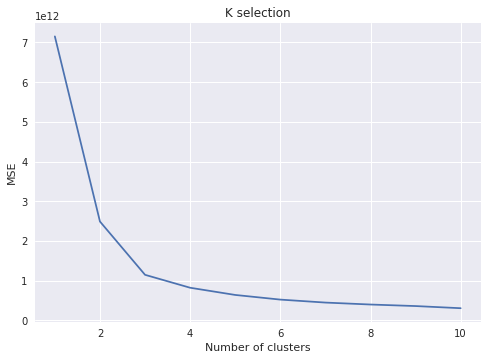

In [55]:
# Finding best k
plt.style.use("seaborn")
Ks = 11
mse = np.zeros((Ks-1))
#NYChouse_clustering = tony_grouped.drop(['Neighborhood','Borough','Neighborhood Latitude','Neighborhood Longitude'], 1)
for n in range(1,Ks):
    
    # set number of clusters
    kclusters = n
    # run k-means clustering
    kmeans = KMeans(n_clusters=kclusters, random_state=0, init = 'random', n_init = 15).fit(NYChouse_df)
    mse[n-1] = kmeans.inertia_

plt.plot(range(1,Ks),mse)
plt.xlabel("Number of clusters")
plt.ylabel("MSE")
plt.title("K selection")
plt.show()

According to the elbow method, the optimal value of k is 3.

In [56]:
# set the number of clusters
k = 3

# running K-Means clustering
kmeans = KMeans(n_init=400, n_clusters=k, random_state=1).fit(NYChouse_df)
kmeans.labels_

# adding the cluster labels to the dataframe
NYChouse_df.insert(0, 'Cluster', kmeans.labels_)
NYChouse_df.head()

,Cluster,zipcode,housing_units,land_area_in_sqmi,lat,lng,median_home_value,median_household_income,occupied_housing_units,population,radius_in_miles,water_area_in_sqmi,county_Bronx,county_Kings,county_Nassau,county_New York,county_Queens,county_Richmond
0,2,10001,12476,0.62,40.750,-73.990,650200.0,81671.0,11031,21102,0.909091,0.0,0,0,0,1,0,0
1,2,10002,34541,0.88,40.720,-73.990,535600.0,33218.0,32925,81410,0.795455,0.0,0,0,0,1,0,0
2,1,10003,31078,0.58,40.730,-73.990,817700.0,92540.0,28559,56024,0.795455,0.0,0,0,0,1,0,0
3,1,10004,2197,0.56,40.700,-74.020,894200.0,129313.0,1692,3089,1.000000,0.0,0,0,0,1,0,0
4,1,10005,5317,0.07,40.705,-74.005,1000001.0,124670.0,4251,7135,0.511364,0.0,0,0,0,1,0,0


Cluster One

In [57]:
# examining each cluster
cluster_one = NYChouse_df[NYChouse_df.Cluster == 0]
cluster_one.sort_values("median_home_value", axis = 0, ascending = True, inplace = True) 
cluster_one

/opt/conda/envs/Python36/lib/python3.6/site-packages/ipykernel/__main__.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  app.launch_new_instance()


,Cluster,zipcode,housing_units,land_area_in_sqmi,lat,lng,median_home_value,median_household_income,occupied_housing_units,population,radius_in_miles,water_area_in_sqmi,county_Bronx,county_Kings,county_Nassau,county_New York,county_Queens,county_Richmond
99,0,10475,18911,1.72,40.87,-73.83,76000.0,43629.0,18534,40931,2.0,0.10,1,0,0,0,0,0
75,0,10451,17779,1.01,40.82,-73.92,170600.0,26754.0,17106,45713,1.0,0.00,1,0,0,0,0,0
92,0,10468,26178,1.08,40.87,-73.90,171200.0,33776.0,24909,76103,1.0,0.02,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
88,0,10464,2272,3.50,40.86,-73.79,484000.0,70078.0,2089,4534,2.0,0.09,1,0,0,0,0,0
119,0,11210,22476,1.64,40.63,-73.95,485500.0,55429.0,20653,62008,1.0,0.00,0,1,0,0,0,0
142,0,11234,33714,7.55,40.61,-73.89,488200.0,68431.0,31213,87757,4.0,0.83,0,1,0,0,0,0


Cluster Two

In [58]:
# examining each cluster
cluster_two = NYChouse_df[NYChouse_df.Cluster == 1]
cluster_two.sort_values("median_home_value", axis = 0, ascending = True, inplace = True) 
cluster_two

/opt/conda/envs/Python36/lib/python3.6/site-packages/ipykernel/__main__.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  app.launch_new_instance()


,Cluster,zipcode,housing_units,land_area_in_sqmi,lat,lng,median_home_value,median_household_income,occupied_housing_units,population,radius_in_miles,water_area_in_sqmi,county_Bronx,county_Kings,county_Nassau,county_New York,county_Queens,county_Richmond
26,1,10029,31121,0.83,40.790,-73.950,787000.0,31888.0,29378,76003,1.000000,0.0,0,0,0,1,0,0
16,1,10019,31404,0.68,40.770,-73.990,808600.0,84424.0,25905,42870,0.909091,0.0,0,0,0,1,0,0
33,1,10036,17958,0.44,40.760,-73.990,810300.0,66599.0,15183,24711,0.852273,0.0,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
62,1,10282,2484,0.09,40.716,-74.015,1000001.0,230952.0,2215,4783,0.227273,0.0,0,0,0,1,0,0
6,1,10007,3143,0.16,40.714,-74.008,1000001.0,216037.0,2840,6988,0.511364,0.0,0,0,0,1,0,0
11,1,10013,13460,0.55,40.720,-74.010,1000001.0,83725.0,12096,27700,1.000000,0.0,0,0,0,1,0,0


Cluster Three

In [59]:
# examining each cluster
cluster_three = NYChouse_df[NYChouse_df.Cluster == 2]
cluster_three.sort_values("median_home_value", axis = 0, ascending = True, inplace = True) 
cluster_three

/opt/conda/envs/Python36/lib/python3.6/site-packages/ipykernel/__main__.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  app.launch_new_instance()


,Cluster,zipcode,housing_units,land_area_in_sqmi,lat,lng,median_home_value,median_household_income,occupied_housing_units,population,radius_in_miles,water_area_in_sqmi,county_Bronx,county_Kings,county_Nassau,county_New York,county_Queens,county_Richmond
172,2,11385,37251,3.61,40.70,-73.88,495800.0,50799.0,34843,98592,3.000000,0.03,0,0,0,0,1,0
166,2,11373,33227,1.53,40.74,-73.88,499600.0,47667.0,31348,100820,0.965909,0.00,0,0,0,0,1,0
176,2,11414,11330,2.30,40.66,-73.85,501700.0,66790.0,10695,26148,1.000000,0.09,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
128,2,11219,28693,1.48,40.63,-74.00,726700.0,34316.0,26177,92221,1.000000,0.00,0,1,0,0,0,0
8,2,10010,18030,0.39,40.73,-73.98,746200.0,97955.0,16556,31834,1.000000,0.00,0,0,0,1,0,0
13,2,10016,35617,0.53,40.74,-73.97,759600.0,105324.0,32173,54183,0.909091,0.00,0,0,0,1,0,0


Now we want to now what the ranges are in each cluster to assign the budget type: Low, Medium, or High Budget

In [60]:
NYCone_min = cluster_one['median_home_value'].min()
NYCone_max = cluster_one['median_home_value'].max()
NYCtwo_min = cluster_two['median_home_value'].min()
NYCtwo_max = cluster_two['median_home_value'].max()
NYCthree_min = cluster_three['median_home_value'].min()
NYCthree_max = cluster_three['median_home_value'].max()

print('The range of Cluster One is ' + str(NYCone_min) + ' - ' + str(NYCone_max))
print('The range of Cluster Two is ' + str(NYCtwo_min) + ' - ' + str(NYCtwo_max))
print('The range of Cluster Three is ' + str(NYCthree_min) + ' - ' + str(NYCthree_max))

The range of Cluster One is 76000.0 - 488200.0
The range of Cluster Two is 787000.0 - 1000001.0
The range of Cluster Three is 495800.0 - 759600.0


So we can assign the budget types to the clusters as followed:
* Cluster One : 76000 - 488200 --> Low Budget
* Cluster Two : 787000 - 1000001 --> High Budget
* Cluster Three : 495800 - 759600 --> Medium Budget

In [61]:
# inserting budget column into each dataframe
cluster_one.insert(0, 'Budget', 'LOW')
cluster_two.insert(0, 'Budget', 'HIGH')
cluster_three.insert(0, 'Budget', 'MEDIUM')

In [62]:
# concatenating all individual cluster dataframes into a single dataframe
NYC_budget = pd.concat([cluster_one, cluster_two, cluster_three], ignore_index=True)
NYC_budget.head()

,Budget,Cluster,zipcode,housing_units,land_area_in_sqmi,lat,lng,median_home_value,median_household_income,occupied_housing_units,population,radius_in_miles,water_area_in_sqmi,county_Bronx,county_Kings,county_Nassau,county_New York,county_Queens,county_Richmond
0,LOW,0,10475,18911,1.72,40.870,-73.830,76000.0,43629.0,18534,40931,2.000000,0.10,1,0,0,0,0,0
1,LOW,0,10451,17779,1.01,40.820,-73.920,170600.0,26754.0,17106,45713,1.000000,0.00,1,0,0,0,0,0
2,LOW,0,10468,26178,1.08,40.870,-73.900,171200.0,33776.0,24909,76103,1.000000,0.02,1,0,0,0,0,0
3,LOW,0,10037,9451,0.26,40.814,-73.937,260200.0,37341.0,8885,17416,0.625000,0.00,0,0,0,1,0,0
4,LOW,0,11372,25100,0.74,40.750,-73.880,265500.0,48683.0,23906,66636,0.909091,0.00,0,0,0,0,1,0


### 4.1.2 Cluster Maps

In [63]:
# create map
NYmap_clusters = folium.Map(location=[NYlatitude, NYlongitude], zoom_start=10, width='100%', height='100%')

# add markers to the map
for lat, lng, zipcode, budget in zip(NYC_budget['lat'], NYC_budget['lng'], NYC_budget['zipcode'], NYC_budget['Budget']):
    if budget == "LOW":
        label = folium.Popup(str(zipcode + " " + budget), parse_html=True)
        folium.CircleMarker([lat, lng], radius=6, popup=label, color='green',fill=True,fill_color='#008000',fill_opacity=2.0,parse_html=False).add_to(NYmap_clusters)
    
    elif budget == "MEDIUM":
        label = folium.Popup(str(zipcode + " " + budget), parse_html=True)
        folium.CircleMarker([lat, lng], radius=5, popup=label, color='orange',fill=True,fill_color='#FF8C00',fill_opacity=2.0,parse_html=False).add_to(NYmap_clusters)
    
    elif budget == "HIGH":
        label = folium.Popup(str(zipcode + " " + budget), parse_html=True)
        folium.CircleMarker([lat, lng], radius=5, popup=label, color='red',fill=True,fill_color='#FF6347',fill_opacity=2.0,parse_html=False).add_to(NYmap_clusters)
      
    
NYmap_clusters

## 4.2 Download and load Toronto Housing Data

In [64]:
body = client_e073509e2b4e4fd9ab9d353e029fb9c7.get_object(Bucket='courseraibmcapstone-donotdelete-pr-iibp9ibtexxq7g',Key='properties.csv')['Body']
# add missing __iter__ method, so pandas accepts body as file-like object
if not hasattr(body, "__iter__"): body.__iter__ = types.MethodType( __iter__, body )

df_data_5 = pd.read_csv(body)

TorHouse = df_data_5
TorHouse.head()

,Unnamed: 0,Address,AreaName,Price ($),lat,lng
0,0,"86 Waterford Dr Toronto, ON",Richview,999888,43.679882,-79.544266
1,1,"#80 - 100 BEDDOE DR Hamilton, ON",Chedoke Park B,399900,43.250000,-79.904396
2,2,"213 Bowman Street Hamilton, ON",Ainslie Wood East,479000,43.251690,-79.919357
3,3,"102 NEIL Avenue Hamilton, ON",Greenford,285900,43.227161,-79.767403
4,6,"#1409 - 230 King St Toronto, ON",Downtown,362000,43.651478,-79.368118


some of the lat and lng are -999, which we need to drop.

In [65]:
#drop the rows with -999 lat and lng
TorHouse = TorHouse[TorHouse.lat != -999]
TorHouse.head()

,Unnamed: 0,Address,AreaName,Price ($),lat,lng
0,0,"86 Waterford Dr Toronto, ON",Richview,999888,43.679882,-79.544266
1,1,"#80 - 100 BEDDOE DR Hamilton, ON",Chedoke Park B,399900,43.250000,-79.904396
2,2,"213 Bowman Street Hamilton, ON",Ainslie Wood East,479000,43.251690,-79.919357
3,3,"102 NEIL Avenue Hamilton, ON",Greenford,285900,43.227161,-79.767403
4,6,"#1409 - 230 King St Toronto, ON",Downtown,362000,43.651478,-79.368118


To make this comparable to the New York City Housing Data, we need to establish the min and max values.  Since we are comparing two cities from different countries and therefore different currencies, currency conversion needs to be taken into consideration.  

The minimum value of the New York City Housing data is 76,000 and the maximum is 1,000,001.  As of today the conversion between the US Dollar to the Canadian Dollar is 1US=1.36CD.  The minimum value of the Toronto Data is 103404 and the maximum is 1,360,590

In [66]:
#Use the Minimum value of $103,404 and the Maximum value of $1,360,590
TorHouse = TorHouse[TorHouse['Price ($)'] > 103404]
TorHouse = TorHouse[TorHouse['Price ($)'] < 1360590]
TorHouse.head()

,Unnamed: 0,Address,AreaName,Price ($),lat,lng
0,0,"86 Waterford Dr Toronto, ON",Richview,999888,43.679882,-79.544266
1,1,"#80 - 100 BEDDOE DR Hamilton, ON",Chedoke Park B,399900,43.250000,-79.904396
2,2,"213 Bowman Street Hamilton, ON",Ainslie Wood East,479000,43.251690,-79.919357
3,3,"102 NEIL Avenue Hamilton, ON",Greenford,285900,43.227161,-79.767403
4,6,"#1409 - 230 King St Toronto, ON",Downtown,362000,43.651478,-79.368118


In [67]:
#double check the work
TorminValue = TorHouse['Price ($)'].min()
TorMaxValue = TorHouse['Price ($)'].max()
print(TorminValue)
print(TorMaxValue)

103500
1359000


In [68]:
#pull only the addresses for Toronto
TorHouse =TorHouse[TorHouse['Address'].str.contains(r'Toronto|toronto')]
TorHouse.head()

,Unnamed: 0,Address,AreaName,Price ($),lat,lng
0,0,"86 Waterford Dr Toronto, ON",Richview,999888,43.679882,-79.544266
4,6,"#1409 - 230 King St Toronto, ON",Downtown,362000,43.651478,-79.368118
12,20,"3 Bracebridge Ave Toronto, ON",Old East York,599900,43.697842,-79.317368
15,23,"#710 - 1080 Bay St Toronto, ON",Downtown,805900,43.666794,-79.388756
17,25,"160 Jenkinson Way Toronto, ON",Dorset Park,549900,43.749599,-79.270844


In [69]:
#concatanate the latitude and longitudes together as coordinates to perform reverse geocoding
TorHouse['Coordinates'] = TorHouse['lat'].map(str) + ', ' + TorHouse['lng'].map(str)
#TorHouse['Coordinates'][0]
TorHouse.head()

,Unnamed: 0,Address,AreaName,Price ($),lat,lng,Coordinates
0,0,"86 Waterford Dr Toronto, ON",Richview,999888,43.679882,-79.544266,"43.679882, -79.54426600000001"
4,6,"#1409 - 230 King St Toronto, ON",Downtown,362000,43.651478,-79.368118,"43.651478000000004, -79.36811800000001"
12,20,"3 Bracebridge Ave Toronto, ON",Old East York,599900,43.697842,-79.317368,"43.697842, -79.317368"
15,23,"#710 - 1080 Bay St Toronto, ON",Downtown,805900,43.666794,-79.388756,"43.666794, -79.388756"
17,25,"160 Jenkinson Way Toronto, ON",Dorset Park,549900,43.749599,-79.270844,"43.749598999999996, -79.270844"


In [70]:
locator = Nominatim(user_agent='myGeocoder', timeout=10)
rgeocode = RateLimiter(locator.reverse, min_delay_seconds=0.001)

tqdm_notebook().pandas()

TorHouse['Address'] = TorHouse['Coordinates'].progress_apply(rgeocode)
TorHouse.head()


,Unnamed: 0,Address,AreaName,Price ($),lat,lng,Coordinates
0,0,"(84, Waterford Drive, Richview Gardens, Etobic...",Richview,999888,43.679882,-79.544266,"43.679882, -79.54426600000001"
4,6,"(55, Sherbourne Street, Moss Park, Toronto Cen...",Downtown,362000,43.651478,-79.368118,"43.651478000000004, -79.36811800000001"
12,20,"(3, Bracebridge Avenue, Woodbine Heights, Beac...",Old East York,599900,43.697842,-79.317368,"43.697842, -79.317368"
15,23,"(Odette Hall, Bay Street, Toronto Centre, Old ...",Downtown,805900,43.666794,-79.388756,"43.666794, -79.388756"
17,25,"(158, Jenkinson Way, Dorset Park, Scarborough,...",Dorset Park,549900,43.749599,-79.270844,"43.749598999999996, -79.270844"


In [71]:
TorHouse.head()

,Unnamed: 0,Address,AreaName,Price ($),lat,lng,Coordinates
0,0,"(84, Waterford Drive, Richview Gardens, Etobic...",Richview,999888,43.679882,-79.544266,"43.679882, -79.54426600000001"
4,6,"(55, Sherbourne Street, Moss Park, Toronto Cen...",Downtown,362000,43.651478,-79.368118,"43.651478000000004, -79.36811800000001"
12,20,"(3, Bracebridge Avenue, Woodbine Heights, Beac...",Old East York,599900,43.697842,-79.317368,"43.697842, -79.317368"
15,23,"(Odette Hall, Bay Street, Toronto Centre, Old ...",Downtown,805900,43.666794,-79.388756,"43.666794, -79.388756"
17,25,"(158, Jenkinson Way, Dorset Park, Scarborough,...",Dorset Park,549900,43.749599,-79.270844,"43.749598999999996, -79.270844"


In [72]:
new_col_list = ['a', 'b']

TorHouse = TorHouse.join(TorHouse.Address.apply(lambda loc: pd.Series(loc, index=new_col_list)))
#if it shows only coordinates, a, and b - will need to make this a new variable/df and then join the columns together with the real
#TorHouse df with the postal codes.

TorHouse.head()

/opt/conda/envs/Python36/lib/python3.6/site-packages/pandas/core/dtypes/cast.py:876: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  v = np.array(v, copy=False)
/opt/conda/envs/Python36/lib/python3.6/site-packages/pandas/core/dtypes/cast.py:1243: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  subarr = np.array(values, dtype=dtype, copy=copy)


,Unnamed: 0,Address,AreaName,Price ($),lat,lng,Coordinates,a,b
0,0,"(84, Waterford Drive, Richview Gardens, Etobic...",Richview,999888,43.679882,-79.544266,"43.679882, -79.54426600000001","84, Waterford Drive, Richview Gardens, Etobico...","(43.679902705048626, -79.54432941850104)"
4,6,"(55, Sherbourne Street, Moss Park, Toronto Cen...",Downtown,362000,43.651478,-79.368118,"43.651478000000004, -79.36811800000001","55, Sherbourne Street, Moss Park, Toronto Cent...","(43.651426, -79.368185)"
12,20,"(3, Bracebridge Avenue, Woodbine Heights, Beac...",Old East York,599900,43.697842,-79.317368,"43.697842, -79.317368","3, Bracebridge Avenue, Woodbine Heights, Beach...","(43.697844339999996, -79.31749736)"
15,23,"(Odette Hall, Bay Street, Toronto Centre, Old ...",Downtown,805900,43.666794,-79.388756,"43.666794, -79.388756","Odette Hall, Bay Street, Toronto Centre, Old T...","(43.6663683, -79.38864324643049)"
17,25,"(158, Jenkinson Way, Dorset Park, Scarborough,...",Dorset Park,549900,43.749599,-79.270844,"43.749598999999996, -79.270844","158, Jenkinson Way, Dorset Park, Scarborough, ...","(43.749561, -79.270824)"


In [73]:
TorHouse.columns

Index(['Unnamed: 0', 'Address', 'AreaName', 'Price ($)', 'lat', 'lng',
       'Coordinates', 'a', 'b'],
      dtype='object')

In [74]:
new_col_list = ['PostalCode'] 
for n,col in enumerate(new_col_list):
     TorHouse[col] = TorHouse['a'].apply(lambda a: a[-15:-8])
TorHouse.head()

,Unnamed: 0,Address,AreaName,Price ($),lat,lng,Coordinates,a,b,PostalCode
0,0,"(84, Waterford Drive, Richview Gardens, Etobic...",Richview,999888,43.679882,-79.544266,"43.679882, -79.54426600000001","84, Waterford Drive, Richview Gardens, Etobico...","(43.679902705048626, -79.54432941850104)",M9R 2R7
4,6,"(55, Sherbourne Street, Moss Park, Toronto Cen...",Downtown,362000,43.651478,-79.368118,"43.651478000000004, -79.36811800000001","55, Sherbourne Street, Moss Park, Toronto Cent...","(43.651426, -79.368185)",M5A 1J7
12,20,"(3, Bracebridge Avenue, Woodbine Heights, Beac...",Old East York,599900,43.697842,-79.317368,"43.697842, -79.317368","3, Bracebridge Avenue, Woodbine Heights, Beach...","(43.697844339999996, -79.31749736)",M4C 4K7
15,23,"(Odette Hall, Bay Street, Toronto Centre, Old ...",Downtown,805900,43.666794,-79.388756,"43.666794, -79.388756","Odette Hall, Bay Street, Toronto Centre, Old T...","(43.6663683, -79.38864324643049)",M5S 3A5
17,25,"(158, Jenkinson Way, Dorset Park, Scarborough,...",Dorset Park,549900,43.749599,-79.270844,"43.749598999999996, -79.270844","158, Jenkinson Way, Dorset Park, Scarborough, ...","(43.749561, -79.270824)",M1P 2S1


In [75]:
TorHouse['PostalCode'].str.contains(',')
TorHouse = TorHouse[~TorHouse.PostalCode.str.contains(', ')]
TorHouse.head(10)

,Unnamed: 0,Address,AreaName,Price ($),lat,lng,Coordinates,a,b,PostalCode
0,0,"(84, Waterford Drive, Richview Gardens, Etobic...",Richview,999888,43.679882,-79.544266,"43.679882, -79.54426600000001","84, Waterford Drive, Richview Gardens, Etobico...","(43.679902705048626, -79.54432941850104)",M9R 2R7
4,6,"(55, Sherbourne Street, Moss Park, Toronto Cen...",Downtown,362000,43.651478,-79.368118,"43.651478000000004, -79.36811800000001","55, Sherbourne Street, Moss Park, Toronto Cent...","(43.651426, -79.368185)",M5A 1J7
12,20,"(3, Bracebridge Avenue, Woodbine Heights, Beac...",Old East York,599900,43.697842,-79.317368,"43.697842, -79.317368","3, Bracebridge Avenue, Woodbine Heights, Beach...","(43.697844339999996, -79.31749736)",M4C 4K7
...,...,...,...,...,...,...,...,...,...,...
27,35,"(34, Ordway Road, Eglinton, Scarborough Southw...",Kennedy Park,599000,43.733814,-79.250000,"43.733814, -79.25","34, Ordway Road, Eglinton, Scarborough Southwe...","(43.73371148114906, -79.24987936156545)",M1K 4M7
28,36,"(43, Waterbeach Crescent, West Humber Estates,...",Rexdale,549900,43.726189,-79.582047,"43.726189, -79.582047","43, Waterbeach Crescent, West Humber Estates, ...","(43.72626505016715, -79.5819958964338)",M9W 4S7
29,37,"(4, Moraine Hill Drive, Tam O'Shanter, Scarbor...",Tam O'Shanter,698000,43.774624,-79.298141,"43.774623999999996, -79.298141","4, Moraine Hill Drive, Tam O'Shanter, Scarboro...","(43.77452655996244, -79.29809953642183)",M1T 1Y4


In [76]:
# one-hot encoding PostalCode

keep = TorHouse[['Price ($)', 'lat', 'lng']]
TorHouse_df = pd.concat([keep,pd.get_dummies(TorHouse['PostalCode'])], axis=1)
TorHouse_df = TorHouse_df.drop(['Ontario'], axis=1)
#TorHouse_df.columns

TorHouse_df.head(10)

,Price ($),lat,lng,M1W2N9,M5A0L1,K7L 1G2,L1A 3S5,L3R 9Z7,L3S 3J9,L3S 4K9,...,M9W 4S7,M9W 5L7,M9W 6A5,M9W 6A6,M9W 6A7,M9W 6K5,M9W 6R2,M9W 6T4,M9W 6V6,N0G 2P0
0,999888,43.679882,-79.544266,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,362000,43.651478,-79.368118,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
12,599900,43.697842,-79.317368,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27,599000,43.733814,-79.250000,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
28,549900,43.726189,-79.582047,0,0,0,0,0,0,0,...,1,0,0,0,0,0,0,0,0,0
29,698000,43.774624,-79.298141,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


## 4.2.1 Clustering the Toronto Housing Data

Find the centriods for KMeans

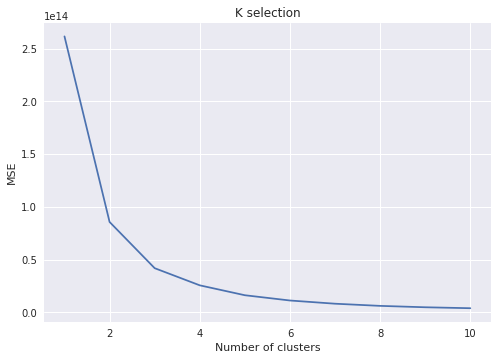

In [77]:
plt.style.use("seaborn")
Ks = 11
mse = np.zeros((Ks-1))
for n in range(1,Ks):
    
    # set number of clusters
    kclusters = n
    # run k-means clustering
    kmeans = KMeans(n_clusters=kclusters, random_state=0, init = 'random', n_init = 15).fit(TorHouse_df)
    mse[n-1] = kmeans.inertia_

plt.plot(range(1,Ks),mse)
plt.xlabel("Number of clusters")
plt.ylabel("MSE")
plt.title("K selection")
plt.show()

According to the elbow method, the optimal value of k is 3.

In [78]:
# set the number of clusters
k = 3

# running K-Means clustering
kmeans = KMeans(n_init=400, n_clusters=k, random_state=1).fit(TorHouse_df)
kmeans.labels_

# adding the cluster labels to the dataframe
TorHouse_df.insert(0, 'Cluster', kmeans.labels_)
TorHouse_df.head()

,Cluster,Price ($),lat,lng,M1W2N9,M5A0L1,K7L 1G2,L1A 3S5,L3R 9Z7,L3S 3J9,...,M9W 4S7,M9W 5L7,M9W 6A5,M9W 6A6,M9W 6A7,M9W 6K5,M9W 6R2,M9W 6T4,M9W 6V6,N0G 2P0
0,2,999888,43.679882,-79.544266,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,1,362000,43.651478,-79.368118,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
12,0,599900,43.697842,-79.317368,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
15,0,805900,43.666794,-79.388756,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
17,0,549900,43.749599,-79.270844,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


Cluster 1

In [79]:
# examining each cluster
Tcluster_one = TorHouse_df[TorHouse_df.Cluster == 0]
Tcluster_one.sort_values("Price ($)", axis = 0, ascending = True, inplace = True) 
Tcluster_one

/opt/conda/envs/Python36/lib/python3.6/site-packages/ipykernel/__main__.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  app.launch_new_instance()


,Cluster,Price ($),lat,lng,M1W2N9,M5A0L1,K7L 1G2,L1A 3S5,L3R 9Z7,L3S 3J9,...,M9W 4S7,M9W 5L7,M9W 6A5,M9W 6A6,M9W 6A7,M9W 6K5,M9W 6R2,M9W 6T4,M9W 6V6,N0G 2P0
18029,0,482500,43.667915,-79.375679,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2302,0,482888,43.770878,-79.411964,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
16665,0,484878,43.640480,-79.394966,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19258,0,829900,43.794025,-79.285156,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
20872,0,829900,43.818554,-79.277954,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2461,0,830000,43.820240,-79.202942,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


Cluster 2

In [80]:
# examining each cluster
Tcluster_two = TorHouse_df[TorHouse_df.Cluster == 1]
Tcluster_two.sort_values("Price ($)", axis = 0, ascending = True, inplace = True) 
Tcluster_two

/opt/conda/envs/Python36/lib/python3.6/site-packages/ipykernel/__main__.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  app.launch_new_instance()


,Cluster,Price ($),lat,lng,M1W2N9,M5A0L1,K7L 1G2,L1A 3S5,L3R 9Z7,L3S 3J9,...,M9W 4S7,M9W 5L7,M9W 6A5,M9W 6A6,M9W 6A7,M9W 6K5,M9W 6R2,M9W 6T4,M9W 6V6,N0G 2P0
21211,1,104900,43.749187,-79.542702,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
20647,1,105000,43.788311,-79.268082,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
15346,1,105000,43.615341,-79.492996,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4295,1,480000,43.645695,-79.376144,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2744,1,480000,43.690044,-79.494453,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
17900,1,482000,43.779987,-79.412735,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


Cluster 3

In [81]:
# examining each cluster
Tcluster_Three = TorHouse_df[TorHouse_df.Cluster == 2]
Tcluster_Three.sort_values("Price ($)", axis = 0, ascending = True, inplace = True) 
Tcluster_Three

/opt/conda/envs/Python36/lib/python3.6/site-packages/ipykernel/__main__.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  app.launch_new_instance()


,Cluster,Price ($),lat,lng,M1W2N9,M5A0L1,K7L 1G2,L1A 3S5,L3R 9Z7,L3S 3J9,...,M9W 4S7,M9W 5L7,M9W 6A5,M9W 6A6,M9W 6A7,M9W 6K5,M9W 6R2,M9W 6T4,M9W 6V6,N0G 2P0
10496,2,834900,43.733833,-79.461113,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1612,2,838000,43.668785,-79.384766,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
17983,2,838000,43.670605,-79.390388,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1714,2,1355000,43.711609,-79.395500,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
22548,2,1358000,43.670319,-79.394432,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
20978,2,1358000,43.670319,-79.394432,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


Now we want to now what the ranges are in each cluster to assign the budget type: Low, Medium, or High Budget

In [82]:
TCone_min = Tcluster_one['Price ($)'].min()
TCone_max = Tcluster_one['Price ($)'].max()
TCtwo_min = Tcluster_two['Price ($)'].min()
TCtwo_max = Tcluster_two['Price ($)'].max()
TCthree_min = Tcluster_Three['Price ($)'].min()
TCthree_max = Tcluster_Three['Price ($)'].max()

print('The range of Cluster One is ' + str(TCone_min) + ' - ' + str(TCone_max))
print('The range of Cluster Two is ' + str(TCtwo_min) + ' - ' + str(TCtwo_max))
print('The range of Cluster Three is ' + str(TCthree_min) + ' - ' + str(TCthree_max))

The range of Cluster One is 482500 - 830000
The range of Cluster Two is 104900 - 482000
The range of Cluster Three is 834900 - 1358000


So we can assign the budget types to the clusters as followed:

* Cluster One : 482500 - 830000 --> Medium Budget
* Cluster Two : 104900 - 482000 --> Low Budget
* Cluster Three : 834900 - 1358000 --> High Budget

In [83]:
# inserting budget column into each dataframe
Tcluster_one.insert(0, 'Budget', 'MEDIUM')
Tcluster_two.insert(0, 'Budget', 'LOW')
Tcluster_Three.insert(0, 'Budget', 'HIGH')

In [84]:
# concatenating all individual cluster dataframes into a single dataframe
Tor_budget = pd.concat([Tcluster_one, Tcluster_two, Tcluster_Three], ignore_index=True)
Tor_budget.head()

,Budget,Cluster,Price ($),lat,lng,M1W2N9,M5A0L1,K7L 1G2,L1A 3S5,L3R 9Z7,...,M9W 4S7,M9W 5L7,M9W 6A5,M9W 6A6,M9W 6A7,M9W 6K5,M9W 6R2,M9W 6T4,M9W 6V6,N0G 2P0
0,MEDIUM,0,482500,43.667915,-79.375679,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,MEDIUM,0,482888,43.770878,-79.411964,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,MEDIUM,0,484878,43.640480,-79.394966,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,MEDIUM,0,484888,43.714592,-79.452911,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,MEDIUM,0,484900,43.776028,-79.412056,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


### 4.2.2 Cluster Maps

In [85]:
# create map
Tmap_clusters = folium.Map(location=[Tlatitude, Tlongitude], zoom_start=10, width='100%', height='100%')

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i+x+(i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lng, budget in zip(Tor_budget['lat'], Tor_budget['lng'], Tor_budget['Budget']):
    if budget == "LOW":
        label = folium.Popup(str(budget), parse_html=True)
        folium.CircleMarker([lat, lng], radius=6, popup=label, color='green',fill=True,fill_color='#008000',fill_opacity=2.0,parse_html=False).add_to(Tmap_clusters)
    
    elif budget == "MEDIUM":
        label = folium.Popup(str(budget), parse_html=True)
        folium.CircleMarker([lat, lng], radius=5, popup=label, color='orange',fill=True,fill_color='#FF8C00',fill_opacity=2.0,parse_html=False).add_to(Tmap_clusters)
    
    elif budget == "HIGH":
        label = folium.Popup(str(budget), parse_html=True)
        folium.CircleMarker([lat, lng], radius=5, popup=label, color='red',fill=True,fill_color='#FF6347',fill_opacity=2.0,parse_html=False).add_to(Tmap_clusters)
         
Tmap_clusters

# 5. Import Data From Foursquare

## 5.1 Set up the credentials

In [86]:
# Define Foursquare Credentials and Version
CLIENT_ID = '5SZD033DFFP1BYV0EJNAO10QIFGX1T2MCSY2JMTQOP5BAYAH'
CLIENT_SECRET = 'WPMLWHCCGOSDK0GXBULP30WM0XEKVC5Y5NQYFZBBU0UA3YLJ'
VERSION = '20180604'
LIMIT = 30
print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: 5SZD033DFFP1BYV0EJNAO10QIFGX1T2MCSY2JMTQOP5BAYAH
CLIENT_SECRET:WPMLWHCCGOSDK0GXBULP30WM0XEKVC5Y5NQYFZBBU0UA3YLJ


## 5.2 Create and sent the GET request

In [87]:
class color:
   PURPLE = '\033[95m'
   CYAN = '\033[96m'
   DARKCYAN = '\033[36m'
   BLUE = '\033[94m'
   GREEN = '\033[92m'
   YELLOW = '\033[93m'
   RED = '\033[91m'
   BOLD = '\033[1m'
   UNDERLINE = '\033[4m'
   END = '\033[0m'

def getNearbyVenues(names, boroughs, latitudes, longitudes, radius=500):
    ind = 1
    venues_list=[]
    for name, borough, lat, lng in zip(names, boroughs, latitudes, longitudes):
        tmp=[]
        print(color.BOLD+str(ind)+" | "+name+color.END)
        ind += 1
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        #tmp.append([(j['venue']['name']) for j in results])
        #for item in tmp[0]:
        #    print("\t",item)
        # return only relevant information for each nearby venue
        venues_list.append([(
            name,
            borough,
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood',
                  'Borough',
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    print("\nDone!")
    return(nearby_venues)

In [88]:
tony_venues = getNearbyVenues(names = TorNY_df['Neighborhood'],
                                   boroughs = TorNY_df['Borough'],
                                   latitudes = TorNY_df['Latitude'],
                                   longitudes = TorNY_df['Longitude']
                                  )

1 | Marble Hill
2 | Chinatown
3 | Washington Heights
4 | Inwood
5 | Hamilton Heights
6 | Manhattanville
7 | Central Harlem
8 | East Harlem
9 | Upper East Side
10 | Yorkville
11 | Lenox Hill
12 | Roosevelt Island
13 | Upper West Side
14 | Lincoln Square
15 | Clinton
16 | Midtown
17 | Murray Hill
18 | Chelsea
19 | Greenwich Village
20 | East Village
21 | Lower East Side
22 | Tribeca
23 | Little Italy
24 | Soho
25 | West Village
26 | Manhattan Valley
27 | Morningside Heights
28 | Gramercy
29 | Battery Park City
30 | Financial District
31 | Carnegie Hill
32 | Noho
33 | Civic Center
34 | Midtown South
35 | Sutton Place
36 | Turtle Bay
37 | Tudor City
38 | Stuyvesant Town
39 | Flatiron
40 | Hudson Yards
41 | Queen's Park
42 | The Beaches
43 | Harbourfront East, Toronto Islands, Union Station
44 | Lawrence Park
45 | Church and Wellesley
46 | Design Exchange, Toronto Dominion Centre
47 | Business Reply Mail Processing Centre 969 Eastern
48 | Berczy Park
49 | The Danforth West, Riverdale
50 | S

## 5.3 One hot encoding and grouping by neighborhoods

In [89]:
# one hot encoding
tony_onehot = pd.get_dummies(tony_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
tony_onehot['Neighborhood'] = tony_venues['Neighborhood'] 
tony_onehot['Borough'] = tony_venues['Borough']
tony_onehot['Neighborhood Latitude'] = tony_venues['Neighborhood Latitude']
tony_onehot['Neighborhood Longitude'] = tony_venues['Neighborhood Longitude']


# move neighborhood column to the first column
fixed_columns = [tony_onehot.columns[-1]] + list(tony_onehot.columns[:-1])
tony_onehot = tony_onehot[fixed_columns]

tony_grouped = tony_onehot.groupby(['Neighborhood','Borough','Neighborhood Latitude','Neighborhood Longitude']).mean().reset_index()

#print(tony_venues.drop_duplicates(["Neighborhood"],inplace = False)['Neighborhood'].reset_index(drop=True))    
tony_grouped

,Neighborhood,Borough,Neighborhood Latitude,Neighborhood Longitude,Adult Boutique,Afghan Restaurant,African Restaurant,Airport,Airport Food Court,Airport Gate,...,Vegetarian / Vegan Restaurant,Veterinarian,Video Game Store,Video Store,Vietnamese Restaurant,Waterfront,Wine Bar,Wine Shop,Women's Store,Yoga Studio
0,"Adelaide, King, Richmond",Downtown Toronto,43.650571,-79.384568,0.0,0.0,0.0,0.0,0.0,0.0,...,0.033333,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0
1,Battery Park City,Manhattan,40.711932,-74.016869,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0
2,Berczy Park,Downtown Toronto,43.644771,-79.373306,0.0,0.0,0.0,0.0,0.0,0.0,...,0.033333,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
76,Washington Heights,Manhattan,40.851903,-73.936900,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.066667,0.0,0.0
77,West Village,Manhattan,40.734434,-74.006180,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.066667,0.000000,0.0,0.0
78,Yorkville,Manhattan,40.775930,-73.947118,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.033333,0.033333,0.0,0.033333,0.066667,0.0,0.0


# 6. Clustering

## 6.1 Find centroids with K-means

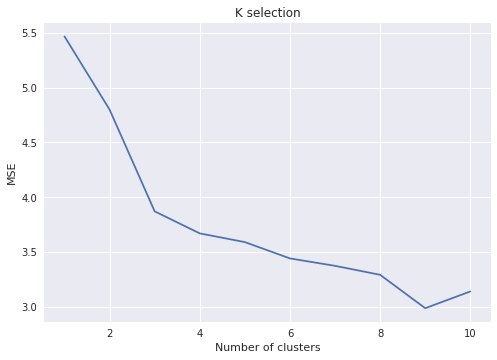

In [90]:
# Finding best k
plt.style.use("seaborn")
Ks = 11
mse = np.zeros((Ks-1))
tony_grouped_clustering = tony_grouped.drop(['Neighborhood','Borough','Neighborhood Latitude','Neighborhood Longitude'], 1)
for n in range(1,Ks):
    
    # set number of clusters
    kclusters = n
    # run k-means clustering
    kmeans = KMeans(n_clusters=kclusters, random_state=0, init = 'random', n_init = 15).fit(tony_grouped_clustering)
    mse[n-1] = kmeans.inertia_

plt.plot(range(1,Ks),mse)
plt.xlabel("Number of clusters")
plt.ylabel("MSE")
plt.title("K selection")
plt.show()

According to the elbow method, 3 clusters are enough to find similarities.

In [91]:
# set number of clusters
kclusters = 3
# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0, init = 'random', n_init = 15).fit(tony_grouped_clustering)
    
tony_merged = TorNY_df

# add clustering labels
tony_merged['Cluster Labels'] = kmeans.labels_

tony_merged

,Borough,Neighborhood,Latitude,Longitude,Cluster Labels
0,Manhattan,Marble Hill,40.876551,-73.910660,2
1,Manhattan,Chinatown,40.715618,-73.994279,2
2,Manhattan,Washington Heights,40.851903,-73.936900,2
...,...,...,...,...,...
76,Downtown Toronto,St. James Town,43.651494,-79.375418,2
77,Downtown Toronto,Christie,43.669542,-79.422564,2
78,West Toronto,"Little Portugal, Trinity",43.647927,-79.419750,2


## 6.2 Display clusters in maps

In [92]:
# create map
map_clusters = folium.Map(location=[centerLatitude, centerLongitude], zoom_start=7, width='100%', height='100%')

for lat, lon, poi, cluster in zip(tony_merged['Latitude'], tony_merged['Longitude'], tony_merged['Neighborhood'], tony_merged['Cluster Labels']):
    if cluster == 0:
        label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
        folium.CircleMarker([lat, lon], radius=6, popup=label, color='green',fill=True,fill_color='#008000',fill_opacity=2.0,parse_html=False).add_to(map_clusters)
    
    elif cluster == 1:
        label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
        folium.CircleMarker([lat, lon], radius=5, popup=label, color='blue',fill=True,fill_color='#0000FF',fill_opacity=2.0,parse_html=False).add_to(map_clusters)
    
    elif cluster == 2:
        label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
        folium.CircleMarker([lat, lon], radius=5, popup=label, color='red',fill=True,fill_color='#FF6347',fill_opacity=2.0,parse_html=False).add_to(map_clusters)
         
map_clusters

New York City - Manhattan

In [93]:
# create map
map_clusters = folium.Map(location=[NYlatitude, NYlongitude], zoom_start=11, width='100%', height='100%')

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(tony_merged['Latitude'], tony_merged['Longitude'], tony_merged['Neighborhood'], tony_merged['Cluster Labels']):
    if cluster == 0:
        label = folium.Popup(str(poi) + ' Cluster ' + str(cluster+1), parse_html=True)
        folium.CircleMarker([lat, lon], radius=6, popup=label, color='green',fill=True,fill_color='#008000',fill_opacity=2.0,parse_html=False).add_to(map_clusters)
    
    elif cluster == 1:
        label = folium.Popup(str(poi) + ' Cluster ' + str(cluster+1), parse_html=True)
        folium.CircleMarker([lat, lon], radius=5, popup=label, color='blue',fill=True,fill_color='#0000FF',fill_opacity=2.0,parse_html=False).add_to(map_clusters)
    
    elif cluster == 2:
        label = folium.Popup(str(poi) + ' Cluster ' + str(cluster+1), parse_html=True)
        folium.CircleMarker([lat, lon], radius=5, popup=label, color='red',fill=True,fill_color='#FF6347',fill_opacity=2.0,parse_html=False).add_to(map_clusters)
    

minimap = MiniMap(position = 'topleft', center_fixed = (NYlatitude, NYlongitude), zoom_level_fixed = 8)
minimap.add_to(map_clusters)

minimap = MiniMap(position='bottomright',  center_fixed = (Tlatitude, Tlongitude), zoom_level_fixed = 8)
minimap.add_to(map_clusters)
map_clusters

Toronto

In [94]:
# create map
map_clusters = folium.Map(location=[Tlatitude, Tlongitude], zoom_start=11, width='100%', height='100%')

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(tony_merged['Latitude'], tony_merged['Longitude'], tony_merged['Neighborhood'], tony_merged['Cluster Labels']):
    if cluster == 0:
        label = folium.Popup(str(poi) + ' Cluster ' + str(cluster+1), parse_html=True)
        folium.CircleMarker([lat, lon], radius=6, popup=label, color='green',fill=True,fill_color='#008000',fill_opacity=2.0,parse_html=False).add_to(map_clusters)
    
    elif cluster == 1:
        label = folium.Popup(str(poi) + ' Cluster ' + str(cluster+1), parse_html=True)
        folium.CircleMarker([lat, lon], radius=5, popup=label, color='blue',fill=True,fill_color='#0000FF',fill_opacity=2.0,parse_html=False).add_to(map_clusters)
    
    elif cluster == 2:
        label = folium.Popup(str(poi) + ' Cluster ' + str(cluster+1), parse_html=True)
        folium.CircleMarker([lat, lon], radius=5, popup=label, color='red',fill=True,fill_color='#FF6347',fill_opacity=2.0,parse_html=False).add_to(map_clusters)

minimap = MiniMap(position = 'topleft', center_fixed = (NYlatitude, NYlongitude), zoom_level_fixed = 8)
minimap.add_to(map_clusters)

minimap = MiniMap(position='bottomright',  center_fixed = (Tlatitude, Tlongitude), zoom_level_fixed = 8)
minimap.add_to(map_clusters)
map_clusters

## 6.3. Analyze Centroids

Cluster 1

In [95]:
cl1 = tony_merged.loc[tony_merged['Cluster Labels'] == 0, tony_merged.columns[[1] + list(range(5, tony_merged.shape[1]))]]
cl1

,Neighborhood
28,Battery Park City
38,Flatiron
49,Studio District
57,"Chinatown, Grange Park, Kensington Market"


Cluster 2

In [96]:
cl2 = tony_merged.loc[tony_merged['Cluster Labels'] == 1, tony_merged.columns[[1] + list(range(5, tony_merged.shape[1]))]]
cl2

,Neighborhood
58,"The Annex, North Midtown, Yorkville"


Cluster 3

In [97]:
pd.set_option('max_rows', 100)
cl3 = tony_merged.loc[tony_merged['Cluster Labels'] == 2, tony_merged.columns[[1] + list(range(5, tony_merged.shape[1]))]]
cl3

,Neighborhood
0,Marble Hill
1,Chinatown
2,Washington Heights
3,Inwood
4,Hamilton Heights
5,Manhattanville
6,Central Harlem
7,East Harlem
8,Upper East Side
9,Yorkville


# 7. Data Visualization

## 7.1 Bar Chart for Cluster Insights

In [100]:
#np.zeros((kmeans.cluster_centers_.shape))

In [101]:
tmp = np.zeros((kmeans.cluster_centers_.shape))
tmp[0,:] = kmeans.cluster_centers_[0,:] 
tmp[1,:] = kmeans.cluster_centers_[1,:] 
tmp[2,:] = kmeans.cluster_centers_[2,:]  

maxi = []
for i in range(3):
    maxi.extend(tmp[i,:].argsort()[-3:][::-1])
  
args = np.asarray(list(set(maxi)))
table = pd.DataFrame(data = tmp[:,args.astype(int)], index = ['Cluster I', 'Cluster II', 'Cluster III'], columns = tony_grouped_clustering.columns[args.astype(int)])
table = table.transpose()

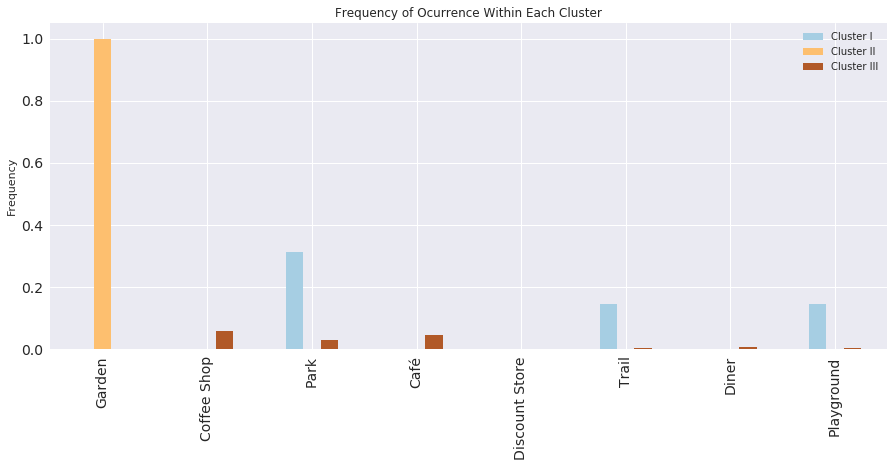

In [102]:
plt.style.use('seaborn')
ax = table.plot(kind='bar', figsize=(15,6), rot=90, fontsize = 14, colormap = 'Paired')
bars = ax.get_children()
plt.title("Frequency of Ocurrence Within Each Cluster")
plt.ylabel("Frequency")

plt.show()

In [113]:
#Show only Cluster 1 and Cluster 3, drop Cluster 2 since that's only Garden
maxi = []
for i in range(3):
    maxi.extend(tmp[i,:].argsort()[-3:][::-1])
    
args = np.asarray(list(set(maxi)))
table = pd.DataFrame(data = tmp[:,args.astype(int)], index = ['Cluster I', 'Cluster II', 'Cluster III'], columns = tony_grouped_clustering.columns[args.astype(int)])
table = table.T
table.drop(["Garden"], inplace= True)

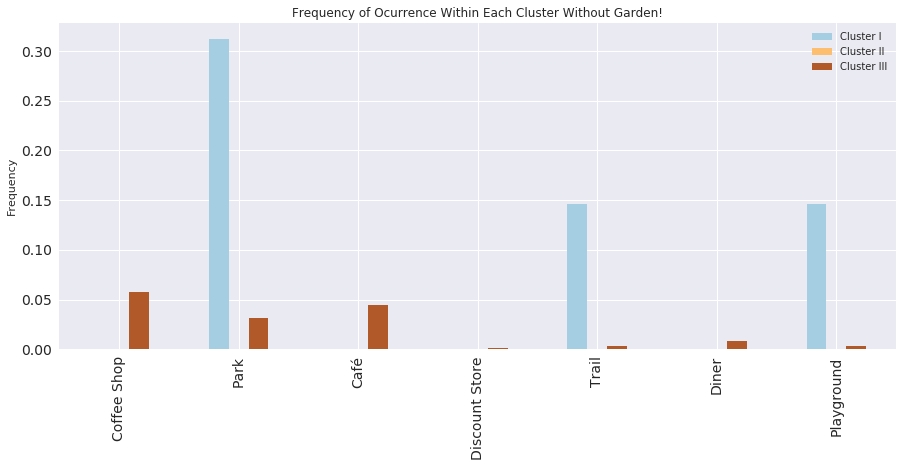

In [114]:
plt.style.use('seaborn')
ax = table.plot(kind='bar', figsize=(15,6), rot=90, fontsize = 14, colormap = "Paired")
bars = ax.get_children()
plt.title("Frequency of Ocurrence Within Each Cluster Without Garden!")
plt.ylabel("Frequency")
plt.show()

### 7.2 Overlay Housing Cluster maps on Crime Heat Maps

#### 7.2.1 New York City

In [103]:
from folium.plugins import MarkerCluster

In [121]:
NYCrimeHouse = folium.Map(location=[NYlatitude, NYlongitude], zoom_start=10, width='100%', height='100%')

folium.Choropleth(
    geo_data = NYCrime_geo,
    name = 'NYC Crime Heat Map',
    data = NY_crime,
    columns = ['Precinct Number', 'Number'],
    key_on = 'feature.properties.Precinct',
    fill_color = 'YlOrRd',
    fill_opacity = 0.7,
    line_opacity = 0.2,
    legend_name = 'Crimes in New York City - Manhattan'
).add_to(NYCrimeHouse)

# add markers to the map
for lat, lng, zipcode, budget in zip(NYC_budget['lat'], NYC_budget['lng'], NYC_budget['zipcode'], NYC_budget['Budget']):
    if budget == "LOW":
        label = folium.Popup(str(zipcode + " " + budget), parse_html=True)
        folium.CircleMarker([lat, lng], radius=4, popup=label, color='green',fill=True,fill_color='#008000',fill_opacity=2.0,parse_html=False).add_to(NYCrimeHouse)
        
    elif budget == "MEDIUM":
        label = folium.Popup(str(zipcode + " " + budget), parse_html=True)
        folium.CircleMarker([lat, lng], radius=3, popup=label, color='orange',fill=True,fill_color='#FF8C00',fill_opacity=2.0,parse_html=False).add_to(NYCrimeHouse)
    
    elif budget == "HIGH":
        label = folium.Popup(str(zipcode + " " + budget), parse_html=True)
        folium.CircleMarker([lat, lng], radius=3, popup=label, color='red',fill=True,fill_color='#FF6347',fill_opacity=2.0,parse_html=False).add_to(NYCrimeHouse)

folium.LayerControl().add_to(NYCrimeHouse)

NYCrimeHouse

#### 7.2.2 Toronto

In [124]:
TorCrimeHouse = folium.Map(location=[Tlatitude, Tlongitude], zoom_start=10, width='100%', height='100%')

folium.Choropleth(
    geo_data =Tor_geo,
    data = Tor_crime,
    columns = ['Neighbourhood','Number'],
    key_on ='feature.properties.AREA_NAME',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name="Crimes in Toronto"
).add_to(TorCrimeHouse)

#map the housing cluster map
for lat, lng, budget in zip(Tor_budget['lat'], Tor_budget['lng'], Tor_budget['Budget']):
    if budget == "LOW":
        label = folium.Popup(str(budget), parse_html=True)
        folium.CircleMarker([lat, lng], radius=3, popup=label, color='green',fill=True,fill_color='#008000',fill_opacity=2.0,parse_html=False).add_to(TorCrimeHouse)
    
    elif budget == "MEDIUM":
        label = folium.Popup(str(budget), parse_html=True)
        folium.CircleMarker([lat, lng], radius=2, popup=label, color='orange',fill=True,fill_color='#FF8C00',fill_opacity=2.0,parse_html=False).add_to(TorCrimeHouse)
    
    elif budget == "HIGH":
        label = folium.Popup(str(budget), parse_html=True)
        folium.CircleMarker([lat, lng], radius=2, popup=label, color='red',fill=True,fill_color='#FF6347',fill_opacity=2.0,parse_html=False).add_to(TorCrimeHouse)        
        
        
folium.LayerControl().add_to(TorCrimeHouse)

TorCrimeHouse